# Наглядный образец работы OCR алгоритма, использующего tesseract

Установить, если необходимо

In [ ]:
!sudo apt install tesseract-ocr
!sudo apt-get install tesseract-ocr-rus

Reading package lists... Done
Building dependency tree       
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2build2).
0 upgraded, 0 newly installed, 0 to remove and 15 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
tesseract-ocr-rus is already the newest version (1:4.00~git30-7274cfa-1).
0 upgraded, 0 newly installed, 0 to remove and 15 not upgraded.


In [ ]:

!pip install timm
!pip install transformers
!pip install pytesseract
!pip install pillow

## Импорт необходимых библиотек и настройки

In [ ]:
# импорты сторонних библиотек
import numpy as np
import pandas as pd
import cv2
import torch
import pytesseract
import subprocess


# импорты модулей текущего проекта
from google.colab.patches import cv2_imshow
from google.colab import drive
from transformers import (
    AutoImageProcessor,
    TableTransformerForObjectDetection,
    TableTransformerModel,
    DetrImageProcessor,
    DetrForObjectDetection,
)
from PIL import Image


# настройки
pytesseract.pytesseract.tesseract_cmd = (
    r"C:\Program Files\Tesseract-OCR\tesseract.exe"
)
ocr_settings = ' - -l rus --oem 3 --psm 7 --dpi 72 -c tessedit_char_whitelist="йцукенгшщзхъфывапролджэячсмитьбю/ЙЦУКЕНГШЩЗХЪФЫВАПРОЛДЖЭЯЧСМИТЬБЮ0123456789().calmg* "'
drive.mount("/content/drive")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# константы
FILE_PATH = r"/content/drive/MyDrive/workshop/233749 .jpg"
CSV_PATH = "/content/drive/MyDrive/workshop/233749.csv"
SLICES_FOLDER = "/content/drive/MyDrive/ocr_slices/"
PRETRAINED_MODEL = "TahaDouaji/detr-doc-table-detection"


## 1. Выделение таблицы

In [ ]:
# распознание рамок таблицы на листе

# открываем изображение
image = Image.open(FILE_PATH).convert("RGB")

# используем претреннированную модель
processor = DetrImageProcessor.from_pretrained(PRETRAINED_MODEL)
model = DetrForObjectDetection.from_pretrained(PRETRAINED_MODEL)

inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)

# конвертим outputs (ограничивающие рамки и логиты классов) к COCO API
# оставим только обнаружения с оценкой > 0.9
target_sizes = torch.tensor([image.size[::-1]])
results = processor.post_process_object_detection(
    outputs, target_sizes=target_sizes, threshold=0.8
)[0]

for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    print(
        f"Detected {model.config.id2label[label.item()]} with confidence "
        f"{round(score.item(), 3)} at location {box}"
    )
box

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Detected table with confidence 0.989 at location [282.43, 2733.59, 2877.99, 3466.03]


[282.43, 2733.59, 2877.99, 3466.03]

In [ ]:
# получаем размеры изначального изображения
orig_size = list(image.size)
orig_size


[3024, 4032]

In [ ]:
# оставляем нижнюю часть изображения, к верхней добавляем немного пикселей
box[3] = orig_size[1]
box[1] = box[1] - 75
box[0] = 0
box[2] = orig_size[0]
box


[0, 2658.59, 3024, 4032]

Обрезаем таблицу

In [ ]:
# обрезаем картинку по координатам
image = image.crop(box)
image.size

# можно вывести если нужно
# image


(3024, 1373)

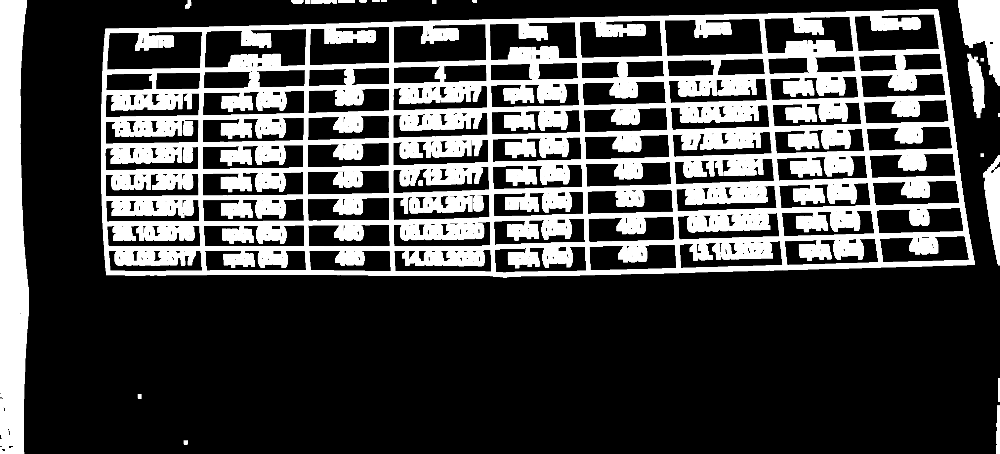

In [ ]:
# преобрабатываем изображение


# переводим изображение в формат array
np_image = np.asarray(image)

# оттенки серого
grayscale_image = cv2.cvtColor(np_image, cv2.COLOR_BGR2GRAY)

# бинаризация
thresholded_image = cv2.threshold(
    grayscale_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
)[1]

# инверсия
inverted_image = cv2.bitwise_not(thresholded_image)

# делаем текст и рамки толще
dilated_image = cv2.dilate(inverted_image, None, iterations=5)
cv2_imshow(dilated_image)

In [ ]:
# преобрабатываем изображение


# переводим изображение в формат array
# np_image = np.asarray(image)

# оттенки серого
# grayscale_image = cv2.cvtColor(np_image, cv2.COLOR_BGR2GRAY)

# бинаризация
# thresholded_image = cv2.threshold(grayscale_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

# инверсия
# inverted_image = cv2.bitwise_not(thresholded_image)

# делаем текст и рамки толще
# dilated_image = cv2.dilate(inverted_image, None, iterations=1)
# cv2_imshow(dilated_image)


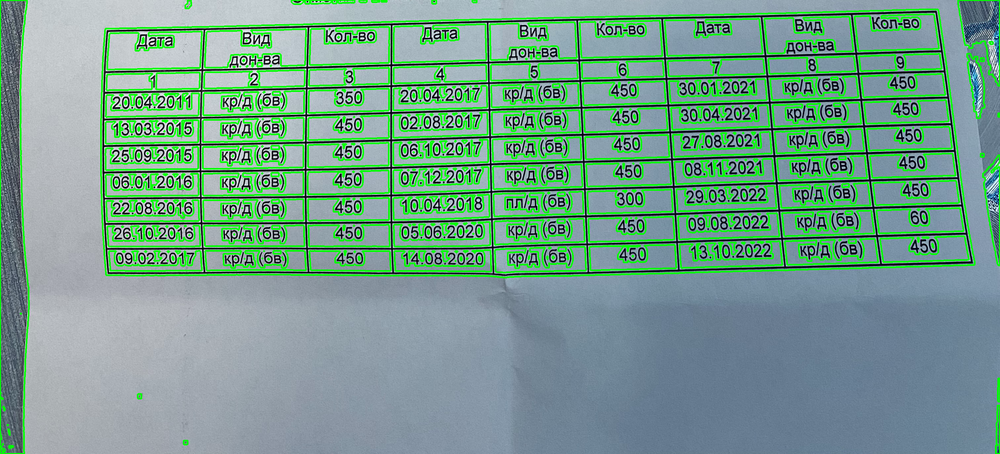

In [ ]:
# выделяем весь текст и контуры

contours, hierarchy = cv2.findContours(
    dilated_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE
)
image_with_all_contours = np_image.copy()
a = cv2.drawContours(image_with_all_contours, contours, -1, (0, 255, 0), 3)

# выводим изображение, если надо
cv2_imshow(a)

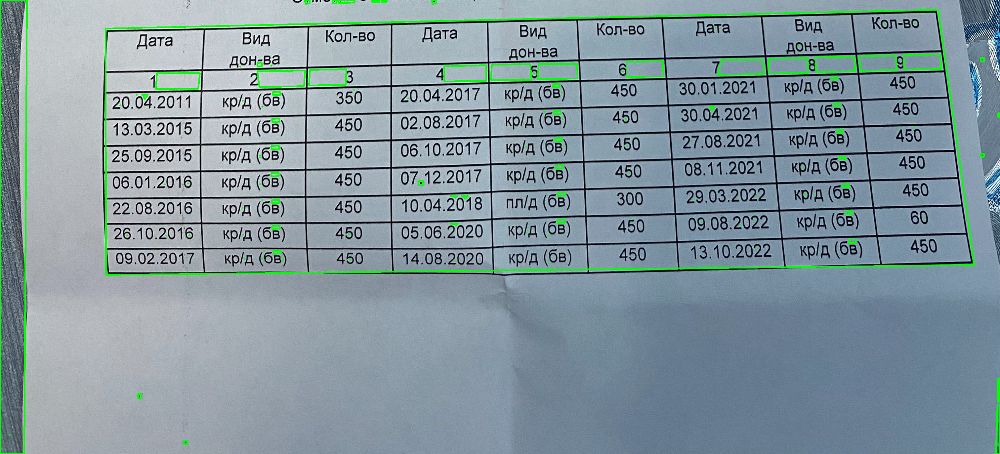

In [ ]:
# оставляем выделенными только ячейки таблицы (без текста)
rectangular_contours = []
for contour in contours:
    peri = cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, 0.02 * peri, True)
    if len(approx) == 4:
        rectangular_contours.append(approx)

image_with_only_rectangular_contours = np_image.copy()
b = cv2.drawContours(
    image_with_only_rectangular_contours, rectangular_contours, -1, (0, 255, 0), 3
)

# выводим изображение, если надо
cv2_imshow(b)

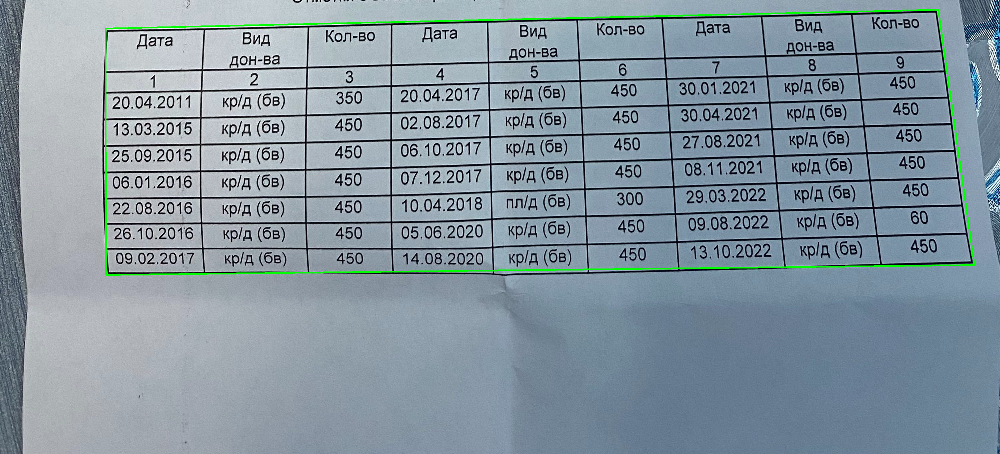

In [ ]:
# оставляем самый большой прямоугольник

max_area = 0
contour_with_max_area = None
for contour in rectangular_contours:
    area = cv2.contourArea(contour)
    if area > max_area:
        max_area = area
        contour_with_max_area = contour

image_with_contour_with_max_area = np_image.copy()
c = cv2.drawContours(
    image_with_contour_with_max_area, [contour_with_max_area], -1, (0, 255, 0), 3
)

# выводим изображение, если надо
cv2_imshow(c)

In [ ]:
# объявляем функцию order_points


def order_points(pts):
    pts = pts.reshape(4, 2)
    rect = np.zeros((4, 2), dtype="float32")
    s = pts.sum(axis=1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    diff = np.diff(pts, axis=1)
    rect[1] = pts[np.argmin(diff)]
    rect[3] = pts[np.argmax(diff)]
    return rect

In [ ]:
# находим края таблицы

contour_with_max_area_ordered = order_points(contour_with_max_area)
image_with_points_plotted = np_image.copy()

for point in contour_with_max_area_ordered:
    point_coordinates = (int(point[0]), int(point[1]))
    image_with_points_plotted = cv2.circle(
        image_with_points_plotted, point_coordinates, 10, (0, 0, 255), -1
    )

# выводим изображение, если надо
# cv2_imshow(image_with_points_plotted)

In [ ]:
# объявляем функцию calculateDistanceBetween2Points


def calculateDistanceBetween2Points(p1, p2):
    dis = ((p2[0] - p1[0]) ** 2 + (p2[1] - p1[1]) ** 2) ** 0.5
    return dis

In [ ]:
# обрезаем и поворачиваем таблицу

existing_image_width = np_image.shape[1]
existing_image_width_reduced_by_10_percent = int(existing_image_width * 0.9)

distance_between_top_left_and_top_right = calculateDistanceBetween2Points(
    contour_with_max_area_ordered[0], contour_with_max_area_ordered[1]
)
distance_between_top_left_and_bottom_left = calculateDistanceBetween2Points(
    contour_with_max_area_ordered[0], contour_with_max_area_ordered[3]
)

aspect_ratio = (
    distance_between_top_left_and_bottom_left / distance_between_top_left_and_top_right
)

new_image_width = existing_image_width_reduced_by_10_percent
new_image_height = int(new_image_width * aspect_ratio)

In [ ]:
pts1 = np.float32(contour_with_max_area_ordered)
pts2 = np.float32(
    [
        [0, 0],
        [new_image_width, 0],
        [new_image_width, new_image_height],
        [0, new_image_height],
    ]
)

matrix = cv2.getPerspectiveTransform(pts1, pts2)

perspective_corrected_image = cv2.warpPerspective(
    dilated_image, matrix, (new_image_width, new_image_height)
)
perspective_corrected_orig_image = cv2.warpPerspective(
    np_image, matrix, (new_image_width, new_image_height)
)

# выводим изображение, если надо
# cv2_imshow(perspective_corrected_orig_image)

In [ ]:
# выводим изображение, если надо
# cv2_imshow(dilated_image)


## Обработка выделенной таблицы

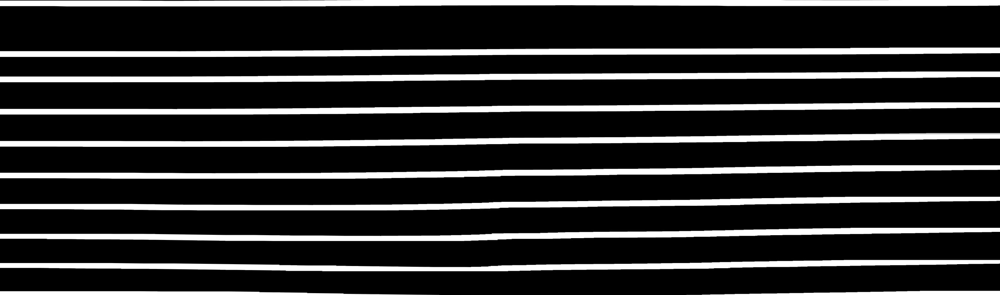

In [ ]:
# находим вертикальные и горизонтльные линии

hor = np.array([[1, 1, 1, 1, 1, 1]])
vertical_lines_eroded_image = cv2.erode(
    perspective_corrected_image, hor, iterations=100
)
vertical_lines_eroded_image = cv2.dilate(
    vertical_lines_eroded_image, hor, iterations=100
)

ver = np.array([[1], [1], [1], [1], [1], [1], [1]])

horizontal_lines_eroded_image = cv2.erode(
    perspective_corrected_image, ver, iterations=100
)
horizontal_lines_eroded_image = cv2.dilate(
    horizontal_lines_eroded_image, ver, iterations=100
)

# выводим изображение, если надо
cv2_imshow(vertical_lines_eroded_image)

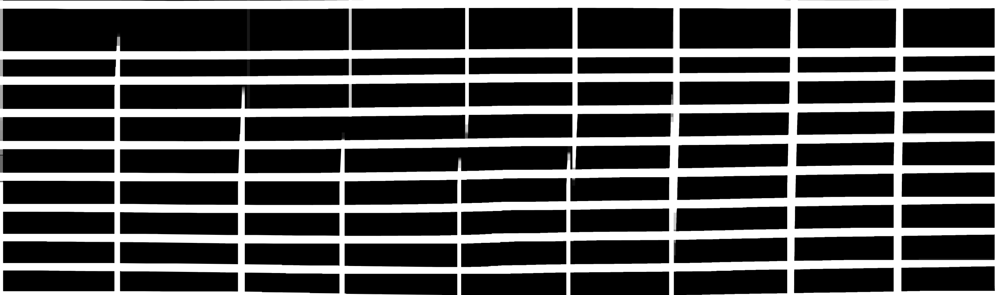

In [ ]:
# объединяем вертикальные линии с горизонтальными

combined_image = cv2.add(
    vertical_lines_eroded_image, horizontal_lines_eroded_image
)

kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
combined_image_dilated = cv2.dilate(combined_image, kernel, iterations=7)

# выводим изображение, если надо
cv2_imshow(combined_image_dilated)


In [ ]:
# объединяем вертикальные линии с горизонтальными

# combined_image = cv2.add(vertical_lines_eroded_image, horizontal_lines_eroded_image)

# kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
# combined_image_dilated = cv2.dilate(combined_image, kernel, iterations=5)

# выводим изображение, если надо
# cv2_imshow(combined_image_dilated)


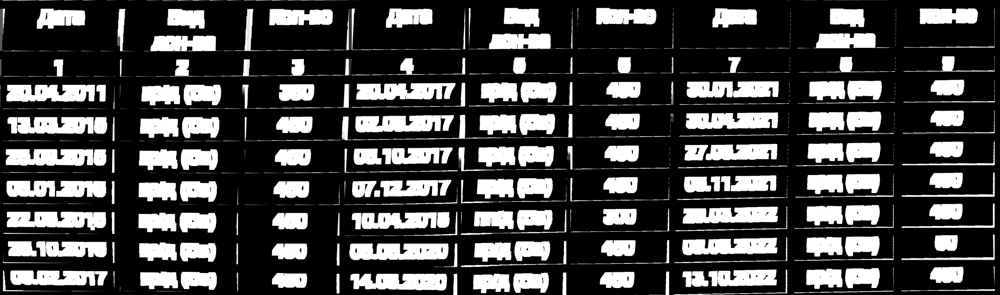

In [ ]:
# удаляем контуры таблицы

image_without_lines = cv2.subtract(
    perspective_corrected_image, combined_image_dilated
)

# выводим изображение, если надо
cv2_imshow(image_without_lines)


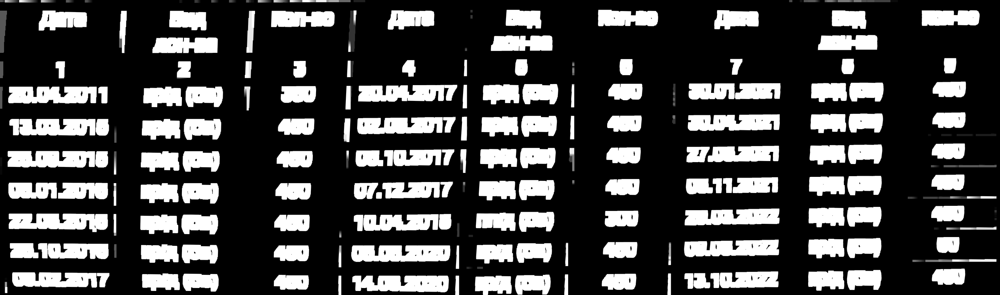

In [ ]:
# удаляем шумы

kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
image_without_lines_noise_removed = cv2.erode(image_without_lines, kernel, iterations=5)
image_without_lines_noise_removed = cv2.dilate(
    image_without_lines_noise_removed, kernel, iterations=5
)

# выводим изображение, если надо
cv2_imshow(image_without_lines_noise_removed)

In [ ]:
# удаляем шумы

# kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
# image_without_lines_noise_removed = cv2.erode(image_without_lines, kernel, iterations=2)
# image_without_lines_noise_removed = cv2.dilate(image_without_lines_noise_removed, kernel, iterations=1)

# выводим изображение, если надо
# cv2_imshow(image_without_lines_noise_removed)


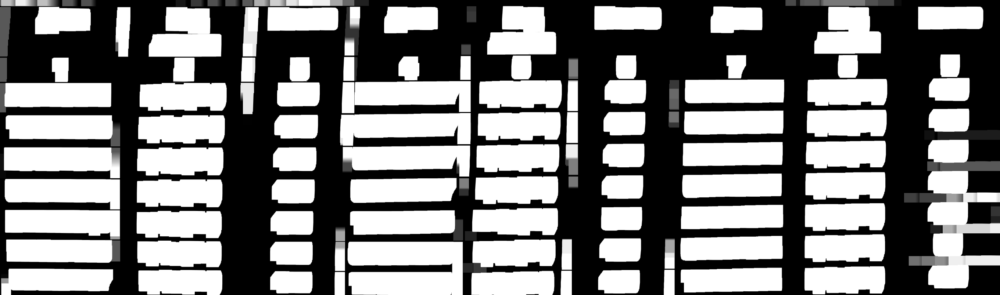

In [ ]:
# размываем текст

kernel_to_remove_gaps_between_words = np.array(
    [[1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]]
)
dilated_image = cv2.dilate(
    image_without_lines_noise_removed, kernel_to_remove_gaps_between_words, iterations=5
)
simple_kernel = np.ones((5, 5), np.uint8)
dilated_image = cv2.dilate(
    image_without_lines_noise_removed, simple_kernel, iterations=5
)

# выводим изображение, если надо
cv2_imshow(dilated_image)

In [ ]:
# размываем текст

# kernel_to_remove_gaps_between_words = np.array([
#                [1,1,1,1,1,1,1,1,1,1],
#               [1,1,1,1,1,1,1,1,1,1]
#        ])
# dilated_image = cv2.dilate(image_without_lines_noise_removed, kernel_to_remove_gaps_between_words, iterations=10)
# simple_kernel = np.ones((5,5), np.uint8)
# dilated_image = cv2.dilate(image_without_lines_noise_removed, simple_kernel, iterations=3)

# выводим изображение, если надо
# cv2_imshow(dilated_image)


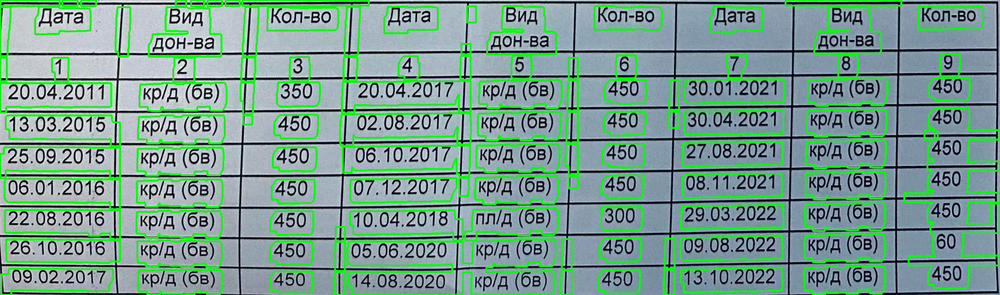

In [ ]:
# находим контуры текста и далее меняем их, приводя к прямоугольному виду

result = cv2.findContours(
    dilated_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE
)
contours = result[0]
image_with_contours_drawn = perspective_corrected_orig_image.copy()
d = cv2.drawContours(image_with_contours_drawn, contours, -1, (0, 255, 0), 3)

# выводим изображение, если надо
cv2_imshow(d)


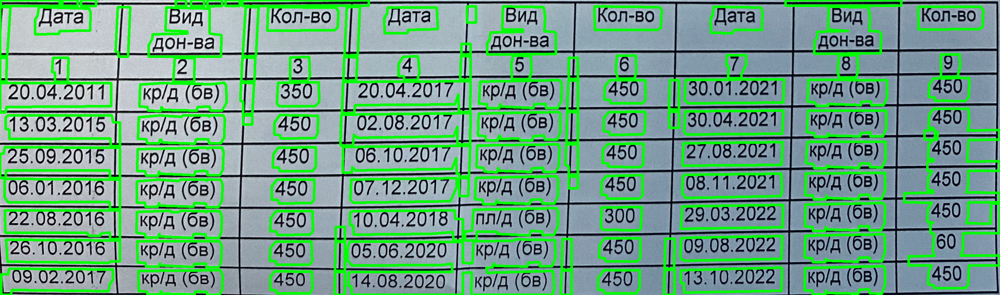

In [ ]:
approximated_contours = []
for contour in contours:
    approx = cv2.approxPolyDP(contour, 3, True)
    approximated_contours.append(approx)

image_with_contours = perspective_corrected_orig_image.copy()
e = cv2.drawContours(
    image_with_contours, approximated_contours, -1, (0, 255, 0), 5
)

# выводим изображение, если надо
cv2_imshow(e)


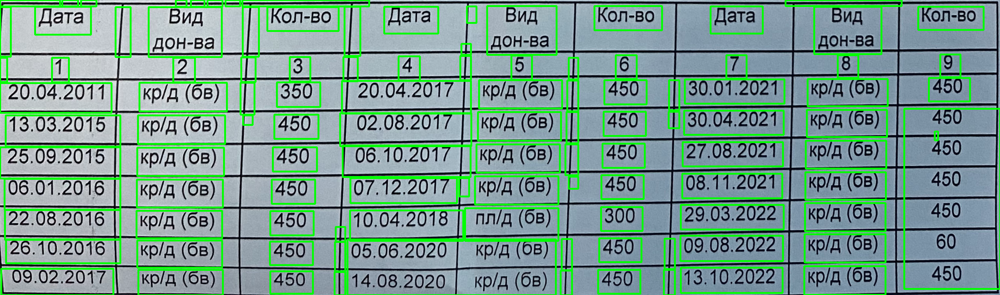

In [ ]:
# делаем контуры для каждой ячейки прямоугольными

bounding_boxes = []
image_with_all_bounding_boxes = perspective_corrected_orig_image.copy()

for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    bounding_boxes.append((x, y, w, h))
    image_with_all_bounding_boxes = cv2.rectangle(
        image_with_all_bounding_boxes, (x, y), (x + w, y + h), (0, 255, 0), 3
    )

# выводим изображение, если надо
cv2_imshow(image_with_all_bounding_boxes)

## Подготовка к OCR

In [ ]:
# объявляем функцию get_mean_height_of_bounding_boxes


def get_mean_height_of_bounding_boxes():
    heights = []
    for bounding_box in bounding_boxes:
        x, y, w, h = bounding_box
        heights.append(h)
    return np.mean(heights)

In [ ]:
bounding_boxes = sorted(bounding_boxes, key=lambda x: x[1])
mean_height = get_mean_height_of_bounding_boxes()
rows = []

half_of_mean_height = mean_height / 2
current_row = [bounding_boxes[0]]
for bounding_box in bounding_boxes[1:]:
    current_bounding_box_y = bounding_box[1]
    previous_bounding_box_y = current_row[-1][1]
    distance_between_bounding_boxes = abs(
        current_bounding_box_y - previous_bounding_box_y
    )
    if distance_between_bounding_boxes <= half_of_mean_height:
        current_row.append(bounding_box)
    else:
        rows.append(current_row)
        current_row = [bounding_box]
rows.append(current_row)

In [ ]:
# сортируем строки
for row in rows:
    row.sort(key=lambda x: x[0])


## Получение предсказаний

In [ ]:
# объявляем функцию get_result_from_tersseract


def get_result_from_tersseract(image_path, ocr_settings):
    output = subprocess.getoutput("tesseract " + image_path + ocr_settings)
    output = output.strip()
    return output

In [ ]:
table = []
current_row = []
image_number = 0

for row in rows:
    for bounding_box in row:
        x, y, w, h = bounding_box
        # y = y - 5
        cropped_image = perspective_corrected_orig_image[y : y + h, x : x + w]
        image_slice_path = SLICES_FOLDER + "img_" + str(image_number) + ".jpg"
        cv2.imwrite(image_slice_path, cropped_image)
        results_from_ocr = get_result_from_tersseract(
            image_slice_path, ocr_settings
        )
        current_row.append(results_from_ocr)
        image_number += 1
    table.append(current_row)
    current_row = []


In [ ]:
# предсказания OCR выглядят так
table


[['а.',
  '',
  'Дата',
  '',
  '',
  '',
  'не.',
  '',
  '.',
  '',
  '',
  'ЖФ дд',
  '',
  'Колво',
  '',
  'Дата',
  '',
  'Ее',
  'Колво',
  'Дата',
  'а',
  'а',
  'Колво'],
 ['',
  'И',
  '2',
  '',
  '3.',
  '',
  '4.',
  '1',
  'ив',
  '5.',
  '',
  '6.',
  '12',
  '8.',
  'ый'],
 ['20.04.2011',
  'кр/д (бв)',
  'ь',
  '350',
  '20.04.2017',
  'кр/д (бв)',
  '',
  '450',
  '',
  '30.01.2021',
  'кр/д (бв)',
  '450'],
 ['13.03.2015',
  'кр/д (в)',
  '',
  '450',
  '02.08.2017',
  'кр/д (бв)',
  '',
  '450',
  '',
  '30.04.2021',
  'кр/д (бв)',
  ''],
 ['25.09.2015',
  'кр/д (бв)',
  '450',
  '06.10.2017',
  'кр/д (бв)',
  '',
  '450',
  '27.08.2021',
  'кр/д (бв)',
  '.'],
 ['06.01.2016',
  'кр/д (бв)',
  '450',
  '07.12.2017',
  '',
  'кр/д (бв)',
  '',
  '450',
  '08.11.2021',
  'кр/д (ов)'],
 ['22.08.2016',
  'кр/д (бв)',
  '450',
  '10.04.2018',
  'пл/Д (98)',
  '300',
  '29.03.2022',
  'кр/д (6в)'],
 ['26.10.2016',
  'кр/д (бв)',
  '450',
  '',
  'И',
  'О ЕВ.',
  '',
  '

## Фильтрация полученной таблицы

In [ ]:
# словарь с расшифровками

don_type = {
    "кр/д": "Цельная кровь",
    "крид": "Цельная кровь",
    "кри": "Цельная кровь",
    "т/ф": "Тромбоциты",
    "п/ф": "Плазма",
    "пл/д": "Плазма",
}
pay_type = {"(бв)": "Безвозмездно", "(6в)": "Безвозмездно", "(пл)": "Платно"}


In [ ]:
# объявим функцию change_values


def change_values(value: str) -> str:
    if value in don_type.keys():
        return don_type[value]
    elif value in pay_type.keys():
        return pay_type[value]
    else:
        return value

In [ ]:
def get_max_row_lenght(table):
    max = 0

    for row in table:
        if len(row) > max:
            max = len(row)
        else:
            continue

    return max


def delete_redundant_elements(table, iter=5):
    filtered_table = table.copy()

    for _ in range(iter):
        for row in filtered_table:
            for item in row:
                if (len(item) < 6) or (len(item) > 12):
                    row.remove(item)

    return filtered_table


def delete_redundant_rows(table, iter=3):
    filtered_table = table.copy()
    max = get_max_row_lenght(table)

    for _ in range(iter):
        for row in filtered_table:
            if (len(row) <= max / 3) or (len(row) <= 2):
                filtered_table.remove(row)

    return filtered_table


def split_don_type(table):
    filtered_table = []

    for row in table:
        filtered_table.append(
            [splitted_item for item in row for splitted_item in item.split()]
        )

    return filtered_table


def raw_table_filter(raw_pred):
    filtered_table = delete_redundant_elements(raw_pred)
    filtered_table = delete_redundant_rows(filtered_table)
    filtered_table = split_don_type(filtered_table)

    return filtered_table

In [ ]:
filtered_table = raw_table_filter(table)
filtered_table

[['20.04.2011',
  'кр/д',
  '(бв)',
  '20.04.2017',
  'кр/д',
  '(бв)',
  '30.01.2021',
  'кр/д',
  '(бв)'],
 ['13.03.2015',
  'кр/д',
  '(в)',
  '02.08.2017',
  'кр/д',
  '(бв)',
  '30.04.2021',
  'кр/д',
  '(бв)'],
 ['25.09.2015',
  'кр/д',
  '(бв)',
  '06.10.2017',
  'кр/д',
  '(бв)',
  '27.08.2021',
  'кр/д',
  '(бв)'],
 ['06.01.2016',
  'кр/д',
  '(бв)',
  '07.12.2017',
  'кр/д',
  '(бв)',
  '08.11.2021',
  'кр/д',
  '(ов)'],
 ['22.08.2016',
  'кр/д',
  '(бв)',
  '10.04.2018',
  'пл/Д',
  '(98)',
  '29.03.2022',
  'кр/д',
  '(6в)'],
 ['26.10.2016', 'кр/д', '(бв)', '09.08.2022', 'кр/д', '(бв)'],
 ['09.02.2017', 'кр/д', '(6в)', '13.10.2022', 'кр/д', '(ов)']]

In [ ]:
max_len = 0
for row in filtered_table:
    if len(row) > max_len:
        max_len = len(row)
row_len = 3
new_table = []
for i in range(len(filtered_table) * int(max_len / 3)):
    new_row = [0 for _ in range(row_len)]
    new_table.append(new_row)
counter = 0
row_counter = 0
if max_len == 8:
    max_len += 1

for i in range(len(filtered_table)):
    if max_len == 6:
        pass
    elif (
        max_len == 9
        and new_table[row_counter][2] == 0
        and new_table[row_counter].count(0) < 3
    ):
        row_counter += 0
    elif max_len == 9 and new_table[row_counter].count(0) == 3:
        if row_counter % 3 == 1:
            row_counter += 2
        elif row_counter % 3 == 2:
            row_counter += 1
    for j in range(len(filtered_table[i])):
        counter = 0
        try:
            datetime_object = pd.to_datetime(
                filtered_table[i][j].strip("."), format="%d.%m.%Y"
            )
            try:
                if new_table[row_counter - 1][2] == 0 and row_counter != 0:
                    row_counter += 1
            except:
                pass
            if new_table[row_counter][counter] != 0:
                row_counter += 1
            new_table[row_counter][counter] = filtered_table[i][j].strip(".")
            continue

        except:
            counter += 1

        if filtered_table[i][j] in don_type.keys():
            if new_table[row_counter][counter] != 0:
                row_counter += 1
            new_table[row_counter][counter] = change_values(filtered_table[i][j])
            continue
        else:
            counter += 1

        if filtered_table[i][j] in pay_type.keys():
            new_table[row_counter][counter] = change_values(filtered_table[i][j])
            row_counter += 1
            continue
        else:
            counter += 1

new_table = pd.DataFrame(
    new_table, columns=["Дата донации", "Класс крови", "Тип донации"]
)
new_table

,Дата донации,Класс крови,Тип донации
0,20.04.2011,Цельная кровь,Безвозмездно
1,20.04.2017,Цельная кровь,Безвозмездно
2,30.01.2021,Цельная кровь,Безвозмездно
3,13.03.2015,Цельная кровь,0
4,02.08.2017,Цельная кровь,Безвозмездно
5,30.04.2021,Цельная кровь,Безвозмездно
6,25.09.2015,Цельная кровь,Безвозмездно
7,06.10.2017,Цельная кровь,Безвозмездно
8,27.08.2021,Цельная кровь,Безвозмездно
9,06.01.2016,Цельная кровь,Безвозмездно


Условия примерные!

Ясно, что потом их нужно будет подбирать по другому

In [ ]:
# df из get_predictions_df нужно дополнительно обработать функцией reshape


def reshape(table, preds):
    if get_max_row_lenght(preds) == 6:
        temp_table_1 = table.iloc[::2, :]
        temp_table_2 = table.iloc[1::2, :]

        reshaped_table = pd.concat([temp_table_1, temp_table_2]).reset_index(drop=True)

        return reshaped_table

    else:
        temp_table_1 = table.iloc[::3, :]
        temp_table_2 = table.iloc[1::3, :]
        temp_table_3 = table.iloc[2::3, :]

        reshaped_table = pd.concat(
            [temp_table_1, temp_table_2, temp_table_3]
        ).reset_index(drop=True)

        return reshaped_table

In [ ]:
table_pred = reshape(new_table, filtered_table)
table_pred

,Дата донации,Класс крови,Тип донации
0,0,Цельная кровь,Безвозмездно
1,0,Цельная кровь,Безвозмездно
2,0,Цельная кровь,Безвозмездно
3,20.07.2011,Цельная кровь,Безвозмездно
4,18.09.2012,Цельная кровь,Безвозмездно
5,30.10.2012,Цельная кровь,Безвозмездно
6,07.12.2012,Цельная кровь,Безвозмездно
7,20.06.2016,0,0
8,26.08.2016,0,0
9,06.03.2017,0,0


## Рассчет accuracy_score

In [ ]:
def accuracy_score(table_pred, table_true):
    if table_pred.shape == table_true.shape:
        rows = int(table_pred.shape[0])
        cols = int(table_pred.shape[1])
        total = rows * cols
        correct = 0

        for row in range(rows):
            for col in range(cols):
                if table_pred.iloc[row, col] == table_true.iloc[row, col]:
                    correct += 1
                else:
                    continue

        return correct / total

    else:
        print("Shapes of table_pred and table_true does not match!")


In [ ]:
# по этим столбцам будем считать accuracy
accuracy_columns = ["Дата донации", "Класс крови", "Тип донации"]

# подготовка таблицы для расчета
table_true = pd.read_csv(CSV_PATH)
table_true = table_true[accuracy_columns]

In [ ]:
accuracy_score(table_pred, table_true)
